# INTRO
L'obiettivo di questo esercizio è quello di costruire un modello di machine learning in grado di distinguere i clienti frodatori dagli altri.

# DATASET
Il dataset è composto sia da colonne in chiaro che da colonne anonomizzate ed è una fotografia mensile dei clienti.
Di seguito la spiegazione delle colonne:

- *data_rif*: data di fine mese di riferimento
- *userid*: id del cliente
- *age*: età 
- *profession*: professione
- *region*: regione di residenza
- *account_balance*: saldo del conto a fine mese
- *num_trx_cd*: numero di transazioni con carta di debito eseguite nel mese
- *num_trx_cc*: numero di transazioni con carta di credito eseguite nel mese
- *num_trx_cp*: numero di transazioni con carta prepagata eseguite nel mese
- *num_mov_conto*: numero di movimenti di conto corrente nel mese
- *sum_mov_conto_pos*: somma degli importi dei movimenti in ingresso di conto corrente nel mese
- *sum_mov_conto_neg*: somma degli importi dei movimenti in uscita di conto corrente nel mese
- *num_prodotti*: numero di prodotti posseduti dal cliente
- *f2*, *f3*, *f4*, *f5*, *f6*, *f7*: features comportamentali anonimizzate
- *TARGET*: variabile target che indica se il cliente ha commesso una frode nei mesi successivi


# REQUISITI AGGIUNTIVI
- Possibile utilizzare qualunque libreria di ML purchè venga fornita la versione in modo da poter replicare i risultati
- Si preferiscono modelli "white-box" o spiegabili

# Libs

In [1]:
# main libs
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.express as px
import seaborn as sns
from pathlib import Path
%matplotlib inline

# user libs
from utils.tools import DataProfiler, auto_fill_na, analyze_nan_fraud_rate, add_anomalous_age, FraudPreprocessor, ModelTrain

# lettura dati

In [2]:
DTYPES = {
    'data_rif': str,
    'userid': np.int64,
    'age':  np.int64,
    'profession': str,
    'region': str,
    'account_balance': np.float64,
    'num_trx_cd': np.float64,
    'num_trx_cc': np.float64,
    'num_trx_cp': np.float64,
    'num_mov_conto': np.int32,
    'sum_mov_conto_pos': np.int64,
    'sum_mov_conto_neg': np.int64,
    'num_prodotti': np.int64,
    'f2': np.int64,
    'f3': np.int64,
    'f4': np.int64,
    'f5': np.int64,
    'f6': np.float64,
    'f7': np.float64,
    'TARGET': np.int64
}

In [3]:
df = pd.read_csv("../data/frauds_dataset.csv", sep="~", dtype=DTYPES)

df_original = df.copy()

# Business Understanding

Dobbiamo costruire un modello di machine learning in grado di distinguere i clienti frodatori dagli altri. Assumimamo che siamo nel ramo della frode bancaria.

Cosa è una frode?

>Reato che consiste nell'ottenere un ingiusto profitto tramite inganni e raggiri nell'ambito del sistema bancario, causando un danno ad altri e alle istituzioni finanziarie. 

Vista la richiesta, dobbiamo togliere la colonna ùserid`in quanto il modello imparerebbe ad associare direttamente l'userid alla frode, senza considerare le altre feature, quindi senza generalizzare il comportamento tipico di un frodatore data la sua sotoriia.
Per lo stesso motivo non considereriamo la colonna `data_rif`, in quanto non determina quando avviene la frode, e quindi potrebbe essere una variabile mal interpretata dal modello.



⚠️ Attenzione ad alcuni fattori:
- Viene detto che la colonna TARGET non identifica una transazione fraudolenta, ma dice solo che quell'userid ha commesso una frode nei mesi successivi. Di contro, *assumiamo* che TARGET = 0 indica chel'userid *non* ha commesso frodi nei mesi successivi. Si potrebbe desumere una finestra nel quale accade la frode.
- Per quanto appena detto, abbiamo una serie temporale per userid di comportamenti pre-frode.
- Non è presente una metrica business sulla quale addestrare il modello (non sappiamo quale è il costo di avere molti falsi positivi o di avere molti falsi negativi)

# Data Understanding
In realtà già presente sopra. Riporto qui,

Il dataset è composto sia da colonne in chiaro che da colonne anonomizzate ed è una fotografia mensile dei clienti.
Di seguito la spiegazione delle colonne:

- *data_rif*: data di fine mese di riferimento
- *userid*: id del cliente
- *age*: età 
- *profession*: professione
- *region*: regione di residenza
- *account_balance*: saldo del conto a fine mese
- *num_trx_cd*: numero di transazioni con carta di debito eseguite nel mese
- *num_trx_cc*: numero di transazioni con carta di credito eseguite nel mese
- *num_trx_cp*: numero di transazioni con carta prepagata eseguite nel mese
- *num_mov_conto*: numero di movimenti di conto corrente nel mese
- *sum_mov_conto_pos*: somma degli importi dei movimenti in ingresso di conto corrente nel mese
- *sum_mov_conto_neg*: somma degli importi dei movimenti in uscita di conto corrente nel mese
- *num_prodotti*: numero di prodotti posseduti dal cliente
- *f2*, *f3*, *f4*, *f5*, *f6*, *f7*: features comportamentali anonimizzate
- *TARGET*: variabile target che indica se il cliente ha commesso una frode nei mesi successivi


```python
DTYPES = {
    'data_rif': str,
    'userid': np.int64,
    'age':  np.int64,
    'profession': str,
    'region': str,
    'account_balance': np.float64,
    'num_trx_cd': np.float64,
    'num_trx_cc': np.float64,
    'num_trx_cp': np.float64,
    'num_mov_conto': np.int32,
    'sum_mov_conto_pos': np.int64,
    'sum_mov_conto_neg': np.int64,
    'num_prodotti': np.int64,
    'f2': np.int64,
    'f3': np.int64,
    'f4': np.int64,
    'f5': np.int64,
    'f6': np.float64,
    'f7': np.float64,
    'TARGET': np.int64
}
```


Resterebbe da capire meglio is significato delle variabili comportamentali anonimizzate e se queste dipendono dal tempo o da altri fattori.
Dalla veloce analisi qui sotto, si intuisce che queste variabili sono stabili per gran parte degli userid e solo una piccola % varia nel tempo.

Inoltre:
- il numero di movimenti del conto non è legato al numero di transazioni con carta di debito/credito/prepagata (ci possono essere movimenti del conto senza che vi siano transazioni con carta e viceversa)
- La somma delle somme in entrata e in uscita non sembra collegata con l'account balance in modo diretto (potrebbero esserci altri movimenti che non sono considerati in queste due colonne) sopratutto per userid che compiono in mesi consecutivi. 




In [4]:
tol = 1e-16

var_df = df.groupby("userid")[["f2","f3","f4","f5","f6","f7"]].var().sort_values(by = 'f2', ascending=False)

all_nan = df.groupby('userid')[["f2","f3","f4","f5","f6","f7"]].apply(lambda x: x.isna().all())

    # Condizione di stabilità: var ~ 0 o tutto NaN
stable_mask = (var_df.fillna(0) <= tol) | all_nan

    # Utenti che hanno TUTTE le feature stabili
stable_users = stable_mask.all(axis=1)

num_stable = stable_users.sum()
num_total = stable_users.shape[0]
perc_stable = num_stable / num_total * 100


print(f"Utenti stabili: {num_stable} su {num_total} ({perc_stable:.2f}%)")

Utenti stabili: 13914 su 13952 (99.73%)


In [5]:
df[df.userid == 1606595].head(10)[['data_rif','userid','account_balance','sum_mov_conto_pos','sum_mov_conto_neg', 'TARGET', 'num_trx_cd','num_trx_cc','num_trx_cp','num_mov_conto','num_prodotti','f2','f3','f4','f5','f6','f7']]

,data_rif,userid,account_balance,sum_mov_conto_pos,sum_mov_conto_neg,TARGET,num_trx_cd,num_trx_cc,num_trx_cp,num_mov_conto,num_prodotti,f2,f3,f4,f5,f6,f7
6240,2022-08-31,1606595,-79974.043773,0,0,0,63.0,13.0,0.0,0,8,88,91,34,181,21.991315,1.211271
10453,2022-09-30,1606595,-46303.320654,0,0,0,145.0,0.0,69.0,0,8,88,91,34,181,21.991315,1.211271
18745,2022-11-30,1606595,-23881.389428,0,0,0,114.0,19.0,15.0,0,8,88,91,34,181,21.991315,1.211271
22906,2022-12-31,1606595,-23646.860696,6487,-1443,0,NaN,0.0,0.0,13,8,88,91,34,181,21.991315,1.211271


# Data Preparation & Visualization
Dal report qui sotto, possiamo notare come la variabile `TARGET` sia correlata positivamente con `num_prodotti` e come le variabili legate alle transizioni con carta siano sparse.

In [6]:
target_col = 'TARGET'
categorical_cols = ['profession', 'region']
date_cols = 'data_rif'

In [7]:
df.describe()

,userid,age,account_balance,num_trx_cd,num_trx_cc,num_trx_cp,num_mov_conto,sum_mov_conto_pos,sum_mov_conto_neg,num_prodotti,f2,f3,f4,f5,f6,f7,TARGET
count,2.498700e+04,24987.000000,24987.000000,24787.000000,24768.000000,24785.000000,24987.000000,24987.000000,24987.000000,24987.000000,24987.000000,24987.000000,24987.000000,24987.000000,24987.000000,24987.000000,24987.000000
mean,1.631175e+06,28.274463,702.805427,48.286965,24.291667,18.896591,9.331052,2332.546724,-2346.747028,3.670709,106.084364,70.632649,27.929763,125.181574,30.667986,0.372991,0.133830
std,3.996488e+05,10.877883,100217.371769,66.131234,35.753175,27.806672,13.796325,4223.145138,4211.384175,3.287661,32.091675,17.388744,14.175770,124.973535,9.994928,0.356163,0.340476
min,1.000038e+06,21.000000,-374425.677903,0.000000,0.000000,0.000000,0.000000,0.000000,-41830.000000,1.000000,44.000000,24.000000,7.000000,14.000000,18.200807,0.078044,0.000000
25%,1.300180e+06,22.000000,-66649.864413,0.000000,0.000000,0.000000,0.000000,0.000000,-3051.000000,1.000000,81.000000,56.000000,13.000000,34.000000,20.838649,0.135014,0.000000
50%,1.596296e+06,24.000000,1403.397600,11.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,101.000000,71.000000,31.000000,70.000000,30.774018,0.195443,0.000000
75%,1.899406e+06,29.000000,68512.445865,83.000000,41.000000,31.000000,16.000000,3024.000000,0.000000,7.000000,129.000000,85.000000,41.000000,184.000000,39.197833,0.559843,0.000000
max,2.599882e+06,77.000000,415678.275504,430.000000,265.000000,189.000000,101.000000,39386.000000,0.000000,15.000000,192.000000,117.000000,92.000000,796.000000,56.034628,2.301594,1.000000


In [36]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 24987 entries, 8290 to 4139
Data columns (total 30 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   data_rif                 24987 non-null  object 
 1   userid                   24987 non-null  int64  
 2   age                      24987 non-null  int64  
 3   profession               24925 non-null  object 
 4   region                   24938 non-null  object 
 5   account_balance          24987 non-null  float64
 6   num_trx_cd               24787 non-null  float64
 7   num_trx_cc               24768 non-null  float64
 8   num_trx_cp               24785 non-null  float64
 9   num_mov_conto            24987 non-null  int32  
 10  sum_mov_conto_pos        24987 non-null  int64  
 11  sum_mov_conto_neg        24987 non-null  int64  
 12  num_prodotti             24987 non-null  int64  
 13  f2                       24987 non-null  int64  
 14  f3                       

In [9]:
DataPro = DataProfiler(df, 
                    profile_kwargs={
                    "correlations": {
                        "pearson":  {"calculate": True},
                        "spearman": {"calculate": True}
                    }
                }
)
DataPro.generate_report()
DataPro.to_notebook()

Generating profiling report...
Report generated successfully.
Displaying report in Jupyter Notebook...


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

100%|██████████| 20/20 [00:00<00:00, 261.36it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## TARGET Distribution
Dal grafico sotto deduciamo che il dataset e sbilanciato, ma non troppo e abbiamo più di 3k di righe che segnalano frodi future. Potremmo applicare dell'unsersampling per bilanciare il dataset. Tuttavia, l'idea è di sfruttare la logit che è robusta agli sbilanciamenti.

In [10]:
# Conteggio tot e percentuali
target_counts = df[target_col].value_counts().sort_index()
target_perc = target_counts / target_counts.sum() * 100


target_counts = df[target_col].value_counts().sort_index()
target_perc = target_counts / target_counts.sum() * 100

df_plot = pd.DataFrame({
    "TARGET": target_counts.index.astype(str),
    "Count": target_counts.values,
    "Percentuale": target_perc.values
})

fig = px.bar(
    df_plot,
    x="TARGET",
    y="Count",
    text=df_plot["Count"].astype(str) + ", " + df_plot["Percentuale"].round(1).astype(str) + "%",
    title="Distribuzione TARGET"
)

fig.update_traces(textposition="outside", marker_color="#1f77b4")
fig.update_layout(
    xaxis_title="TARGET",
    yaxis_title="Count",
    template="plotly_white",
    margin=dict(t=50)
)

fig.show()

print("Distribuzione TARGET (con percentuali):")
print(pd.DataFrame({"count": target_counts, "perc": target_perc.round(2)}))

Distribuzione TARGET (con percentuali):
        count   perc
TARGET              
0       21643  86.62
1        3344  13.38


## NaN management
Dal grafico sopra, notiamo che ci sono valori mancanti per le colonne `region`, `profession`, `num_trx_cd`, `num_trx_cc`, `num_trx_cp`.
- Per le colonne categoriche legate a userid (ovvero `region` e `profession`), andiamo a sostituire i NaN con la moda per userid
- Per le colonne numeriche, che sono le varie transazioni con carte, andiamo a capire cosa significano i NaN. 
- Infine, per tutte le colonne, capiamo se i NaN hanno un significato importante legato  alla colonna TARGET


### Region & Profession

In [11]:
df = auto_fill_na(df, cols=categorical_cols)


Report subsitutions:
profession: NaN before=187, filled=125, after=62
region: NaN before=190, filled=141, after=49


### Transazioni con carta

Su un totale di 25k transazioni, i nan presenti nelle transazioni con carta sono pochi, mentre gli zeri sono molti. Questo potrebbe suggerire che i NaN derivino da errori nel recepire i dati o seplicemente che quell'userid non ha intestato quella tipologia di carta (questa ipotesi meno forte visto che ci sono userid che hanno e non hanno NaN per quella tipologia). Inoltre, non esistono righe per cui si hanno tre NaN contemporaneamente.

In conclusione, preferisco non toccare i NaN per queste variabili

In [12]:
for col in ['num_trx_cd', 'num_trx_cc', 'num_trx_cp']:
    len_nan = len(df[df[col].isna()])
    len_0 = len(df[df[col] < 1])

    print(f"Numero di righe con NaN in {col}: {len_nan}")
    print(f"Numero di righe con 0 in {col}: {len_0}\n")
    
print(f"Totale righe: {len(df)}")

Numero di righe con NaN in num_trx_cd: 200
Numero di righe con 0 in num_trx_cd: 11410

Numero di righe con NaN in num_trx_cc: 219
Numero di righe con 0 in num_trx_cc: 12596

Numero di righe con NaN in num_trx_cp: 202
Numero di righe con 0 in num_trx_cp: 12560

Totale righe: 24987


In [13]:
userid_list = df.iloc[df[df['num_trx_cd'].isna()].index].userid.unique()

df[df['userid'].isin(userid_list)].groupby('userid')[['num_trx_cd', 'num_trx_cc', 'num_trx_cp']].count().sort_values(by='num_trx_cd', ascending=False)

,num_trx_cd,num_trx_cc,num_trx_cp
userid,,,
1606595,3,4,4
1266232,3,4,4
1757147,3,4,4
1755675,3,4,4
1750411,3,4,3
...,...,...,...
1178025,0,1,1
1737763,0,1,1
1725405,0,1,1


In [14]:
df[df.userid == 1266232]

,data_rif,userid,age,profession,region,account_balance,num_trx_cd,num_trx_cc,num_trx_cp,num_mov_conto,sum_mov_conto_pos,sum_mov_conto_neg,num_prodotti,f2,f3,f4,f5,f6,f7,TARGET
909,2022-07-31,1266232,22,Lavoratore dipendente,SARDEGNA,-56057.382813,156.0,0.0,0.0,0,0,0,2,74,61,8,49,45.712246,0.65563,0
5068,2022-08-31,1266232,22,Lavoratore dipendente,SARDEGNA,-94908.954013,16.0,0.0,0.0,0,0,0,2,74,61,8,49,45.712246,0.65563,0
9243,2022-09-30,1266232,22,Lavoratore dipendente,SARDEGNA,-23972.654593,NaN,0.0,36.0,14,4466,-3276,2,74,61,8,49,45.712246,0.65563,0
17566,2022-11-30,1266232,22,Lavoratore dipendente,SARDEGNA,-70298.532886,48.0,0.0,11.0,0,0,0,2,74,61,8,49,45.712246,0.65563,0


### NaN vs Target
Dall' analisi qui sotto notiamo che
- `profession` e `region` hanno una significatività importante: se queste variabili non sono valorizzate, allora potrebbe esserci dipendenza con la variabile TARGET
- `num_trx_cd` segnale debole, non possiamo concludere molto.
- `num_trx_cc` e `num_trx_cp` non sembrano avere dipendenza con TARGET

In conclusione, per le variabili `profession`, `region` andiamo a sostituire i NaN con una nuova categoria "Unknown". Per le altre variabili, non facciamo nulla (o al più buttaimo a 0 i NaN)

NaN summary (fraud rate confronto NaN vs Non-NaN con test statistico):


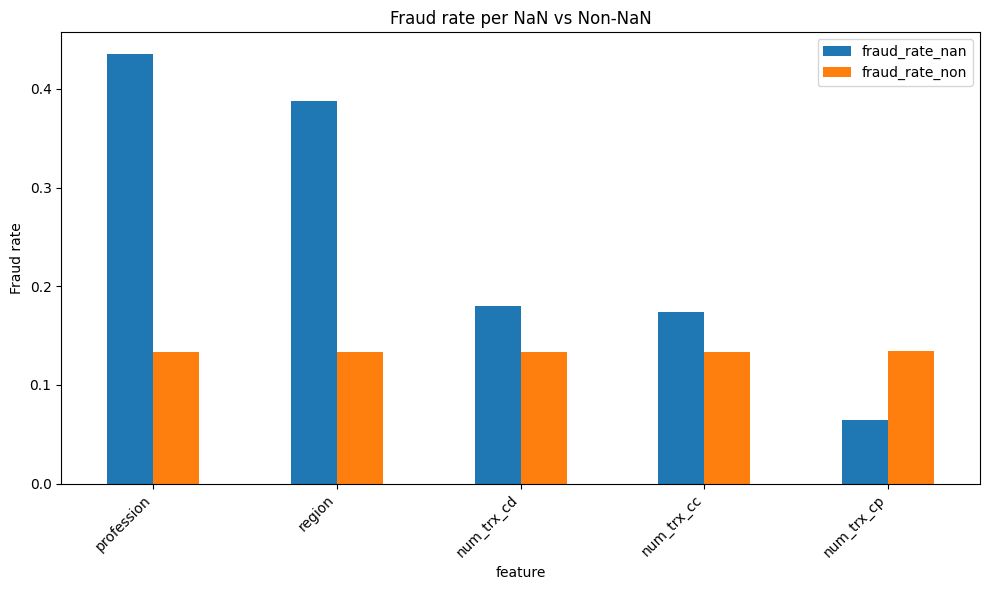

,feature,nan_count,nan_perc,fraud_rate_nan,fraud_rate_non,diff,p_value
0,profession,62,0.002481,0.435484,0.133079,0.302405,1.058820e-11
1,region,49,0.001961,0.387755,0.133331,0.254424,5.281310e-07
2,num_trx_cd,200,0.008004,0.180000,0.133457,0.046543,6.856885e-02
3,num_trx_cc,219,0.008765,0.173516,0.133479,0.040037,1.024852e-01
4,num_trx_cp,202,0.008084,0.064356,0.134396,-0.070039,4.982554e-03


In [16]:
analyze_nan_fraud_rate(df, target_col=target_col)


In [37]:
df = df.drop(columns = ['is_nan_num_trx_cd',	'is_nan_num_trx_cc', 'is_nan_num_trx_cp', 'is_nan_profession', 'is_nan_region'])

KeyError: "['is_nan_num_trx_cd', 'is_nan_num_trx_cc', 'is_nan_num_trx_cp'] not found in axis"

## Analisi delle distribuzioni
Dalla distribuzioni delle varaibili numeriche, notiamo che molte di queste sono molto asimmetriche e con outlier. Per questo motivo, potrebbe essere necessaria una trasformazione logaritmica o una gestione degli outlier se necessario. Inoltre, nessuna variabile è così 'discriminante' (forse da investigare `age` e `f5`), quindi sarà necessario un po' di feature engineering.

Curioso il caso di sum_mov_conto_pos e sum_mov_conto_neg vs num_mov_conto. Sembra ci sia una somma minima legata al numero dei movimenti (ha senso se esistono dei minimi per movimento)

Dagli scatter plot e dai box plot, notiamo che:
- `num_prodotti` sembra essere leggermente discriminante, i frodatori tendono ad avere più prodotti.
- `account_balance`che a priori poteva essere una variabile interessante, non sembra esserlo. Distribuzione normale come media e mediana in piccole rispetto al range

<Figure size 1500x1500 with 0 Axes>

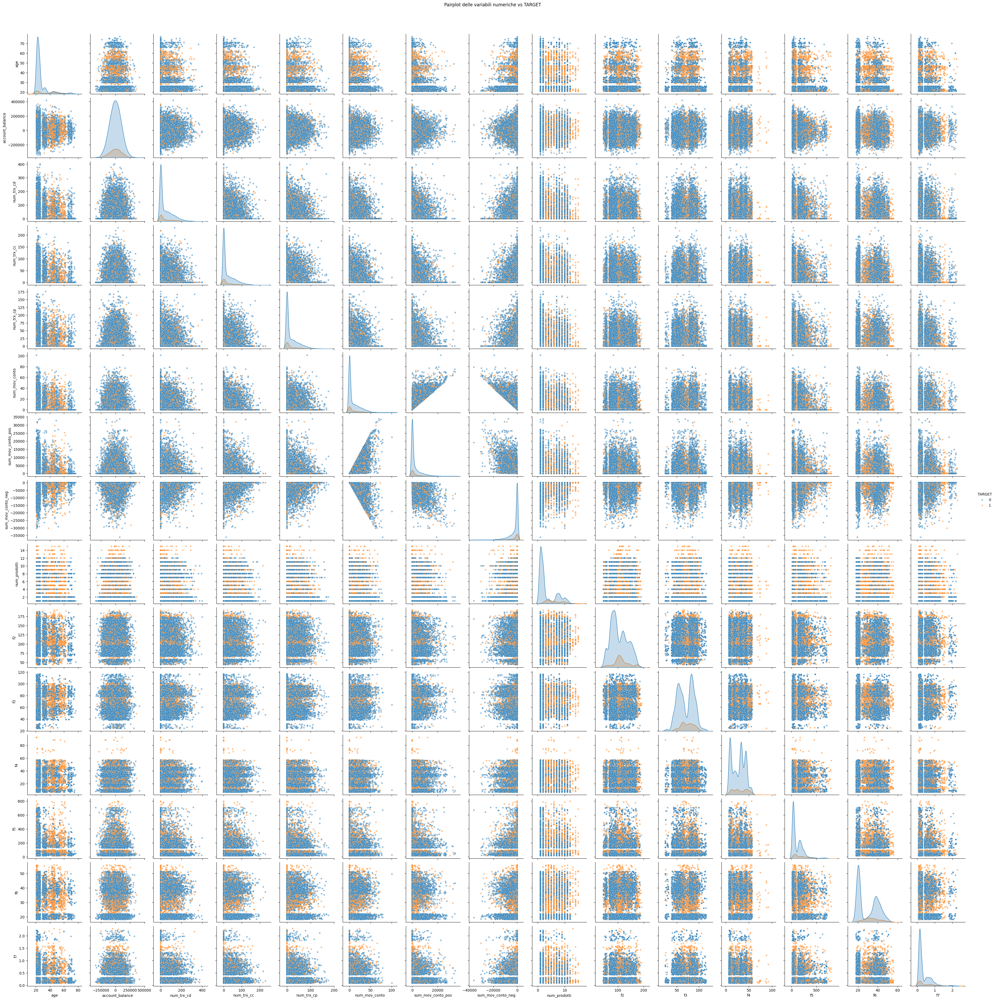

In [18]:
num_cols = [
    "age", "account_balance",
    "num_trx_cd", "num_trx_cc", "num_trx_cp",
    "num_mov_conto", "sum_mov_conto_pos", "sum_mov_conto_neg", "num_prodotti", "f2", "f3", "f4", "f5", "f6", "f7"
]
plt.figure(figsize=(25, 25))
# Pairplot con hue = TARGET
sns.pairplot(
    df[num_cols + [target_col]].sample(10000, random_state=42),  # sample per performance
    hue=target_col,
    diag_kind="kde",  
    plot_kws=dict(alpha=0.5, s=20)  
)

plt.suptitle("Pairplot delle variabili numeriche vs TARGET", y=1.02)
plt.show()

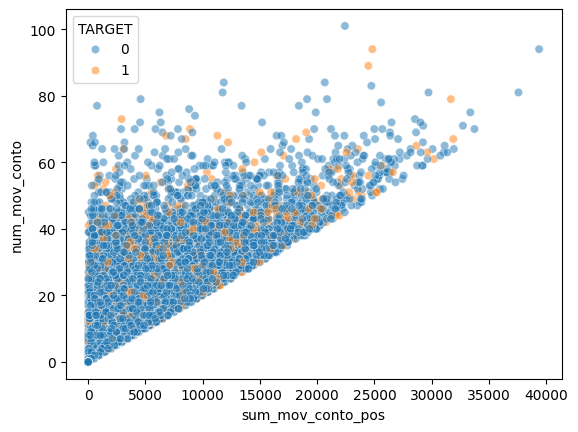

In [19]:
sns.scatterplot(data=df, x="sum_mov_conto_pos", y="num_mov_conto", hue=target_col, alpha=0.5)
plt.show()

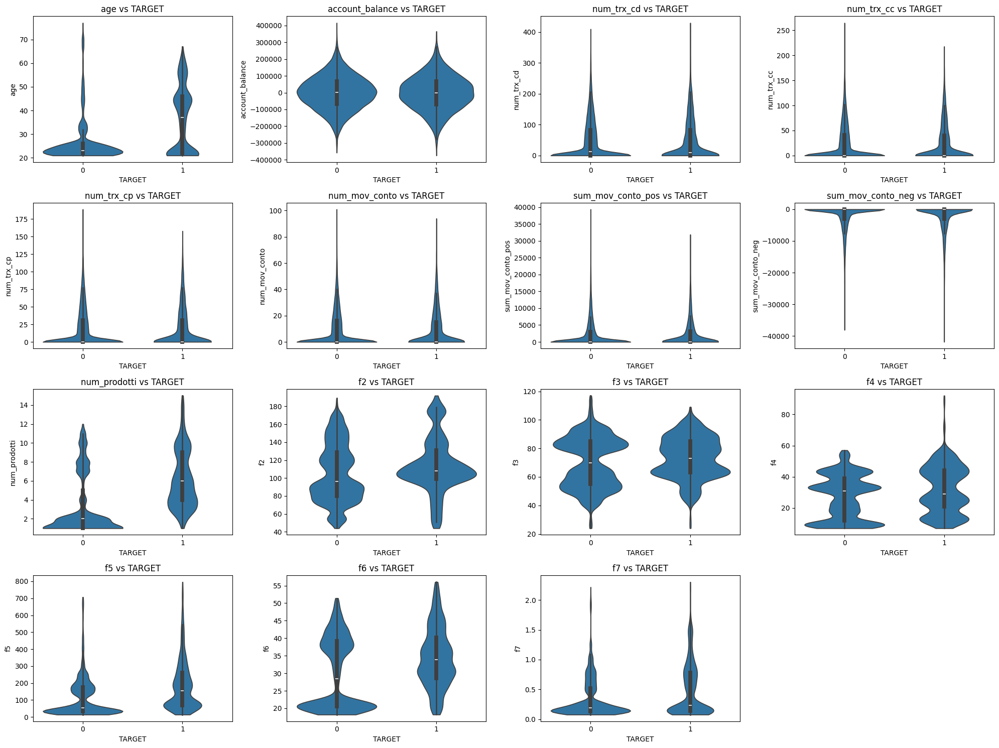

In [20]:
import math

# Imposta dimensioni e griglia
n_cols = 4
n_rows = math.ceil(len(num_cols) / n_cols)

fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 15))
axes = axes.flatten()  # così accediamo facilmente agli assi

# Crea un violin plot per ciascuna variabile numerica
for i, col in enumerate(num_cols):
    sns.violinplot(
        data=df,
        x=target_col,
        y=col,
        ax=axes[i],
        inner="box",  # così vedi anche mediane e quartili
        cut=0
    )
    axes[i].set_title(f"{col} vs {target_col}")

# Spegni gli assi vuoti (se la griglia è più grande del numero di variabili)
for j in range(len(num_cols), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [21]:
df[df.userid == 1000510]

,data_rif,userid,age,profession,region,account_balance,num_trx_cd,num_trx_cc,num_trx_cp,num_mov_conto,...,num_prodotti,f2,f3,f4,f5,f6,f7,TARGET,is_nan_profession,is_nan_region
0,2022-07-31,1000510,23,Lavoratore autonomo,TOSCANA,65627.799269,0.0,0.0,0.0,10,...,2,88,60,8,20,21.141686,0.268369,0,False,False
16634,2022-11-30,1000510,23,Lavoratore autonomo,TOSCANA,-21300.629960,0.0,0.0,0.0,0,...,2,88,60,8,20,21.141686,0.268369,0,False,False
20834,2022-12-31,1000510,23,Lavoratore autonomo,TOSCANA,-40430.554092,0.0,0.0,99.0,9,...,2,88,60,8,20,21.141686,0.268369,0,False,False


## Data Preparation
Passiamo ora alla preparazione dei dati. Quindi ci dedicheremo alla feature eng, alla codifica delle variabili categoriche e alla trasformazione / standarizzazione di variabili numeriche.

Notiamo che:
- ` age` ha dei valori anomali per `userid`, ovvero ci sono userid che hanno età diverse in mesi diversi. Creiamo una colonna per gestire questo caso. Notiamo che 	`anomalous_age` è un forte indicatore locale (se compare, sospetta frode), ma ha bassa potenza predittiva globale (non appare abbastanza spesso per spiegare molto della variabilità di TARGET).

### Gestione Age

In [22]:
df = add_anomalous_age(df)

print("Numero di righe con età anomala:", df['anomalous_age'].sum())
print("Numero di utenti con età anomala:", df[df['anomalous_age']].userid.nunique())
print("Numero totale di utenti fraudolenti:", df[df['TARGET'] == 1].userid.nunique())

Numero di righe con età anomala: 60
Numero di utenti con età anomala: 33
Numero totale di utenti fraudolenti: 3338


In [23]:
from scipy.stats import chi2_contingency, pearsonr


# Tabella di contingenza
contingency = pd.crosstab(df["anomalous_age"], df["TARGET"])
print("Contingency table:\n", contingency, "\n")

# Test Chi-quadrato di indipendenza
chi2, p, dof, expected = chi2_contingency(contingency)
print(f"Chi2 = {chi2:.3f}, p-value = {p:.6f}, dof = {dof}")
print("Expected frequencies:\n", pd.DataFrame(expected, index=contingency.index, columns=contingency.columns), "\n")

# Correlazione di Pearson (φ per variabili booleane)
pearson_r, p_pearson = pearsonr(df["anomalous_age"].astype(int), df["TARGET"].astype(int))
print(f"Pearson r (phi) = {pearson_r:.4f}, p-value = {p_pearson:.6f}\n")


rates = (
    df.groupby("anomalous_age")["TARGET"]
      .agg(["count", "sum"])
      .rename(columns={"count": "n", "sum": "n_TARGET_1"})
)
rates["rate_TARGET_1"] = rates["n_TARGET_1"] / rates["n"]
print("Rates by anomalous_age:\n", rates, "\n")

# Calcolo del lift: P(TARGET=1 | anomalous_age=True) / P(TARGET=1 | anomalous_age=False)
p1_true = rates.loc[True, "rate_TARGET_1"] if True in rates.index else float("nan")
p1_false = rates.loc[False, "rate_TARGET_1"] if False in rates.index else float("nan")
lift = p1_true / p1_false if pd.notna(p1_true) and pd.notna(p1_false) and p1_false != 0 else float("nan")
print(f"Lift (TARGET|anomalous_age=True vs False) = {lift:.3f}")

Contingency table:
 TARGET             0     1
anomalous_age             
False          21602  3325
True              41    19 

Chi2 = 15.800, p-value = 0.000070, dof = 1
Expected frequencies:
 TARGET                    0            1
anomalous_age                           
False          21591.029775  3335.970225
True              51.970225     8.029775 

Pearson r (phi) = 0.0263, p-value = 0.000031

Rates by anomalous_age:
                    n  n_TARGET_1  rate_TARGET_1
anomalous_age                                  
False          24927        3325       0.133389
True              60          19       0.316667 

Lift (TARGET|anomalous_age=True vs False) = 2.374


### Feature Eng
Ecco le variabili che creeremo:
- `anomalous_age`: colonna booleana che indica se l'age di quell'userid è anomalo o meno
- `ratio_pos_neg`: rapporto tra somma movimenti in entrata e somma movimenti in uscita
- `ratio_balance_per_sum`: rapporto tra saldo del conto e somma dei movimenti (in entrata e in uscita)
- `ratio_balance_per_mov`: rapporto tra saldo del conto e numero di movimenti del conto
- `trx_per_balance`: rapporto tra numero di movimenti del conto e saldo (medio) del conto per userid
- `ratio_balance_per_prod`: rapporto tra saldo del conto e numero di prodotti
- `cat_prodotti`: categorizzazione del numero di prodotti





In [ ]:

tol = 1e-16
df['ratio_pos_neg'] = df['sum_mov_conto_pos'] / (abs(df['sum_mov_conto_neg']) + tol)

df['ratio_balance_per_sum'] = df['account_balance'] / (df['sum_mov_conto_pos'] + abs(df['sum_mov_conto_neg']) + tol)
                
df['ratio_balance_per_mov'] = df['account_balance'] / (df['num_mov_conto'] + tol)
                
mean_balance = df.groupby("userid")["account_balance"].transform("mean").abs()               
df["trx_per_balance"] = df["num_mov_conto"] / (mean_balance + tol)
                

df['ratio_balance_per_prod'] = df['account_balance'] / (df['num_prodotti'] + tol)
                
df['cat_prodotti'] = pd.cut(
    df['num_prodotti'],
    bins=[0, 3, 9, np.inf],
    labels=['low ','medium','high']
                )


In [29]:
NewDataProf = DataProfiler(df)
NewDataProf.generate_report()
NewDataProf.to_notebook()

# Training Modello
Per resatere sull'mabito del white-box model, andiamo ad utilizzare una regressione logistica i cui coefficienti sono immediatamente interpretabili. Altrimenti potevamo pensare a qualcosa di più complesso come un random forest o un xgboost e poi plottare le feature importance o usare SHAP. Ma in questo esercizio, la logit va bene. Iniziamo con modelli semplici, magari funzionano già bene.

In [30]:
RANDOM_STATE = 42

In [31]:

from sklearn.metrics import recall_score, make_scorer


In [32]:
X_train, X_test, y_train, y_test = FraudPreprocessor(
    df_original,
    random_state=RANDOM_STATE).split_data()

Creating New features:
 ratio_pos_neg
 ratio_balance_per_sum
 ratio_balance_per_mov
 trx_per_balance
 ratio_balance_per_prod
 cat_prodotti
 anomalous_age
Data split into train and test sets with test size 0.2.


## Esperimenti
- Logistic Regression
- Logistic Regression + Fine Tuning
- Decision Tree
- Decision Tree + Fine Tuning
- Random Forest
- Random Forest + Fine Tuning

In [34]:
"""
import mlflow
from mlflow.models import infer_signature

host = "127.0.0.1"
port = "8080"
if mlflow.active_run() is not None:
    print("Ending active MLflow run...")
    mlflow.end_run()
mlflow.set_tracking_uri(uri=f"http://{host}:{port}")
mlflow.set_experiment("Fraud Detection")
"""

2025/09/30 18:57:01 INFO mlflow.tracking.fluent: Experiment with name 'Fraud Detection' does not exist. Creating a new experiment.


<Experiment: artifact_location='mlflow-artifacts:/296212722143189239', creation_time=1759251421732, experiment_id='296212722143189239', last_update_time=1759251421732, lifecycle_stage='active', name='Fraud Detection', tags={}>

Building estimator and pipeline for logreg...
Fitting pipeline without RandomizedSearchCV...
Computing predicted probabilities...
Evaluation complete.


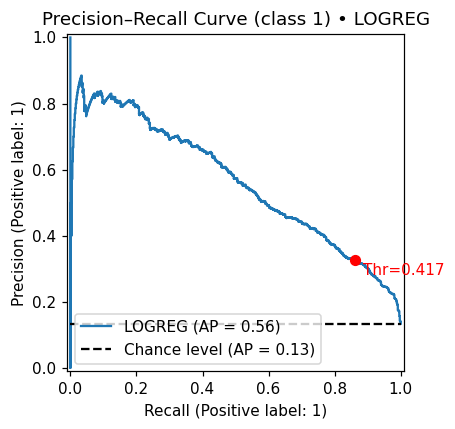


--- Beeswarm Plot (Effect and Distribution) ---
Top-15 feature importance by abs(coef_):


/opt/anaconda3/envs/esercizio-env/lib/python3.12/site-packages/mlflow/types/utils.py:452: UserWarning:

Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details.

Successfully registered model 'logreg_simple'.
2025/09/30 19:05:48 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: logreg_simple, version 1
Created version '1' of 

🏃 View run logreg_simple at: http://127.0.0.1:8080/#/experiments/296212722143189239/runs/979143fb455f4977838acb0e9a3967cb
🧪 View experiment at: http://127.0.0.1:8080/#/experiments/296212722143189239
Building estimator and pipeline for logreg...
Running RandomizedSearchCV (n_iter=30, scoring='make_scorer(recall_score, response_method='predict', pos_label=1)')...
Best params found by RandomizedSearchCV: {'solver': 'liblinear', 'penalty': 'l2', 'C': 0.001}
Fit complete.
Computing predicted probabilities...
Evaluation complete.


<Figure size 1000x800 with 0 Axes>

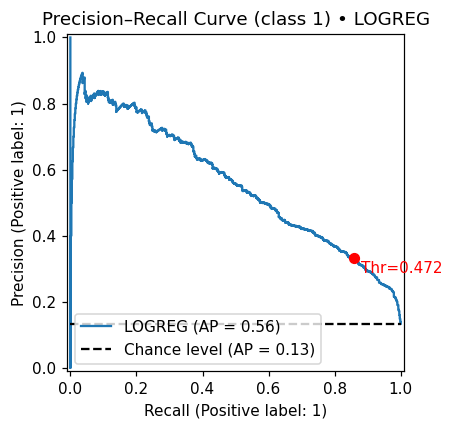


--- Beeswarm Plot (Effect and Distribution) ---
Top-15 feature importance by abs(coef_):


/opt/anaconda3/envs/esercizio-env/lib/python3.12/site-packages/mlflow/types/utils.py:452: UserWarning:

Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details.

Successfully registered model 'logreg_with_fine_tuning'.
2025/09/30 19:07:05 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: logreg_with_fine_tuning, version 1
Cre

🏃 View run logreg_with_fine_tuning at: http://127.0.0.1:8080/#/experiments/296212722143189239/runs/ee98210ae148464c981f8e7d9f952189
🧪 View experiment at: http://127.0.0.1:8080/#/experiments/296212722143189239
Building estimator and pipeline for dt...
Fitting pipeline without RandomizedSearchCV...
Computing predicted probabilities...
Evaluation complete.


<Figure size 1000x800 with 0 Axes>

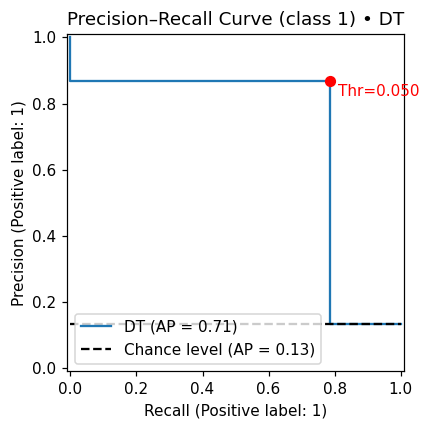


--- Beeswarm Plot (Effect and Distribution) ---
Beeswarm plot saved to: artifacts/dt/shap_beeswarm_dt_simple.png


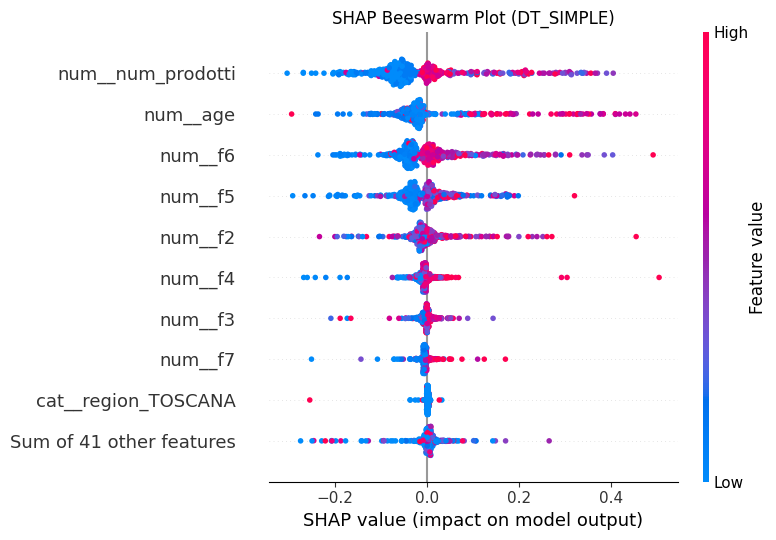


--- Global Feature Importance (Mean Absolute SHAP) ---
Global importance bar plot saved to: artifacts/dt/shap_global_bar_dt_simple.png


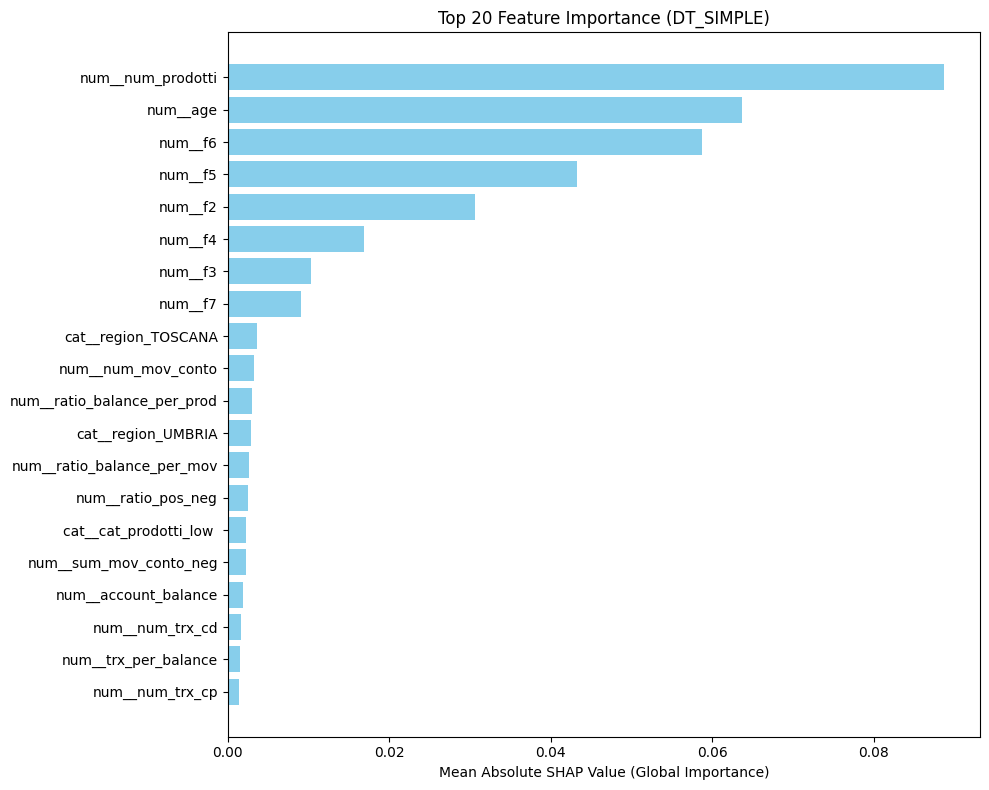


--- Waterfall: False Negative (why it failed) ---
Waterfall plot saved to: artifacts/dt/shap_waterfall_False_Negative__y_1__p_0__dt_simple.png


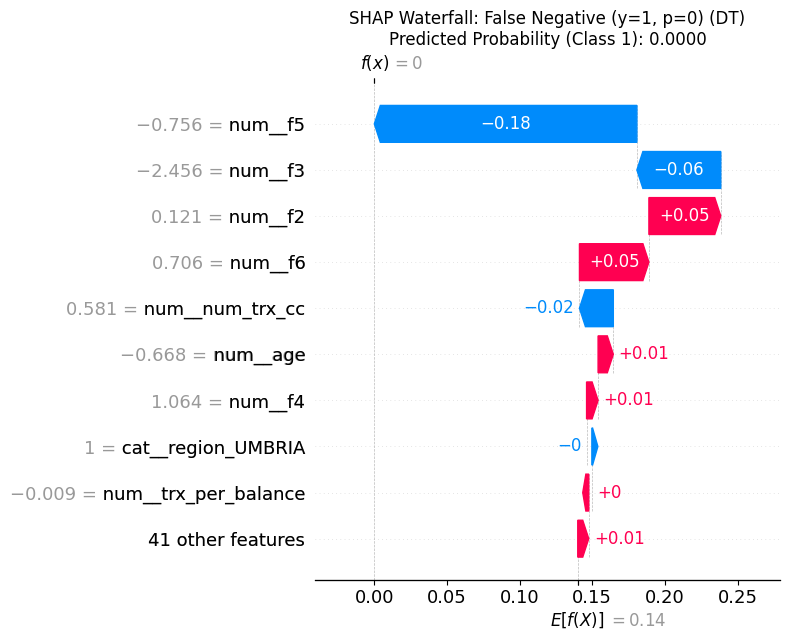


--- Waterfall: True Positive (why it succeeded) ---
Waterfall plot saved to: artifacts/dt/shap_waterfall_True_Positive__y_1__p_1__dt_simple.png


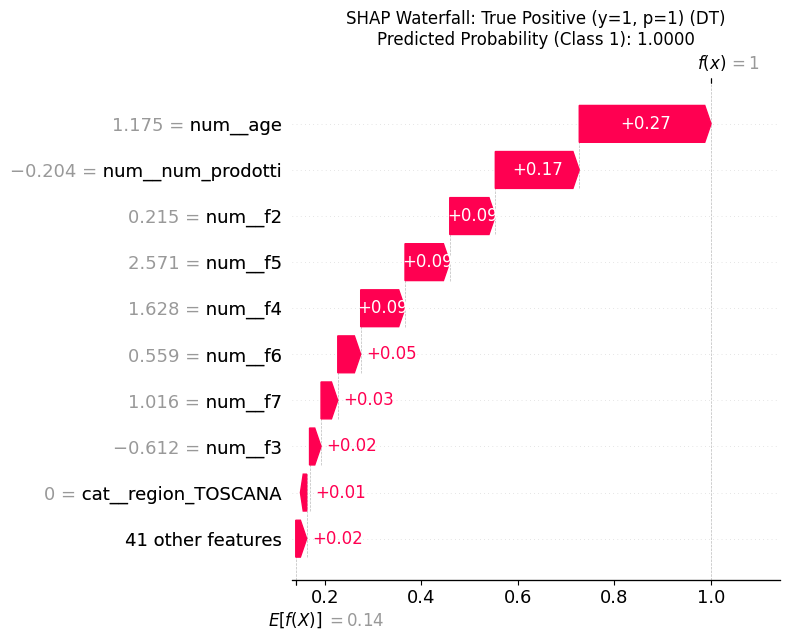

Rendering Decision Tree (Max Depth: 4)...


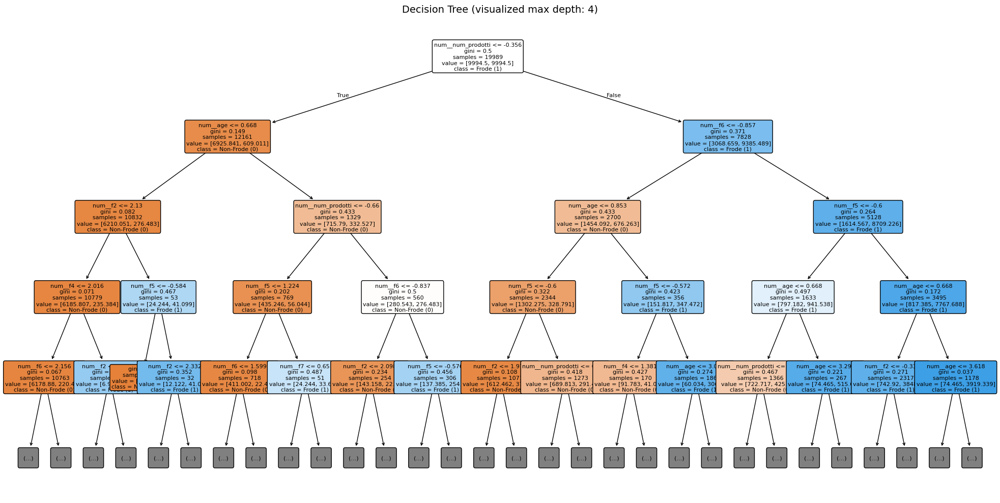

Tree saved to: artifacts/dt/decision_tree_dt_simple.png
Top-15 feature importance by feature_importances_:


/opt/anaconda3/envs/esercizio-env/lib/python3.12/site-packages/mlflow/types/utils.py:452: UserWarning:

Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details.

Successfully registered model 'dt_simple'.
2025/09/30 19:07:22 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: dt_simple, version 1
Created version '1' of model 'd

🏃 View run dt_simple at: http://127.0.0.1:8080/#/experiments/296212722143189239/runs/d6e8267c4aa242a89fefdf74c58ee53a
🧪 View experiment at: http://127.0.0.1:8080/#/experiments/296212722143189239
Building estimator and pipeline for dt...
Running RandomizedSearchCV (n_iter=30, scoring='make_scorer(recall_score, response_method='predict', pos_label=1)')...
Best params found by RandomizedSearchCV: {'min_samples_split': 2, 'max_depth': 5, 'criterion': 'gini'}
Fit complete.
Computing predicted probabilities...
Evaluation complete.


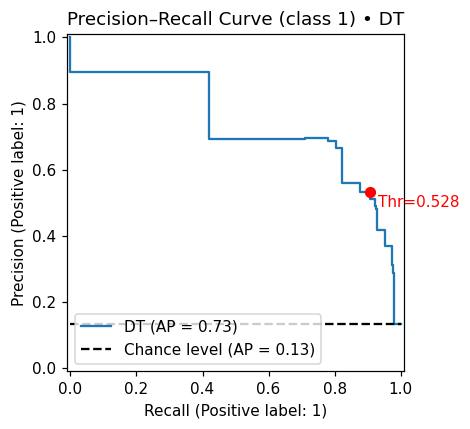


--- Beeswarm Plot (Effect and Distribution) ---
Beeswarm plot saved to: artifacts/dt/shap_beeswarm_dt_with_fine_tuning.png


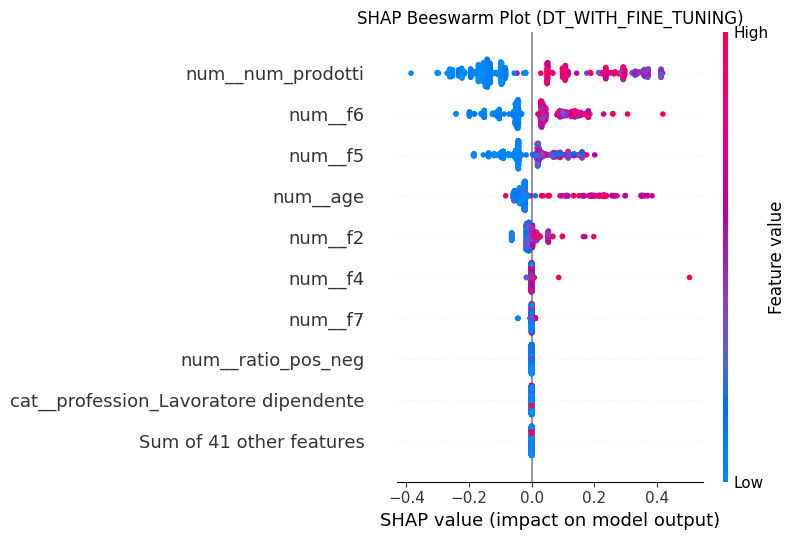


--- Global Feature Importance (Mean Absolute SHAP) ---
Global importance bar plot saved to: artifacts/dt/shap_global_bar_dt_with_fine_tuning.png


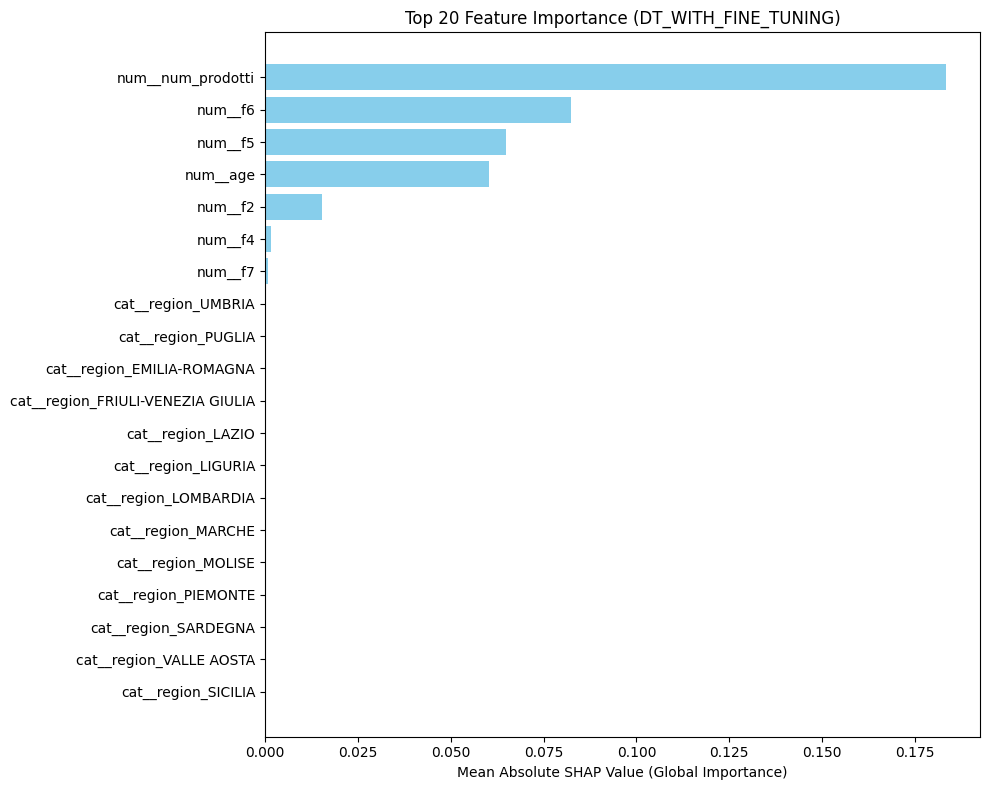


--- Waterfall: False Negative (why it failed) ---
Waterfall plot saved to: artifacts/dt/shap_waterfall_False_Negative__y_1__p_0__dt_with_fine_tuning.png


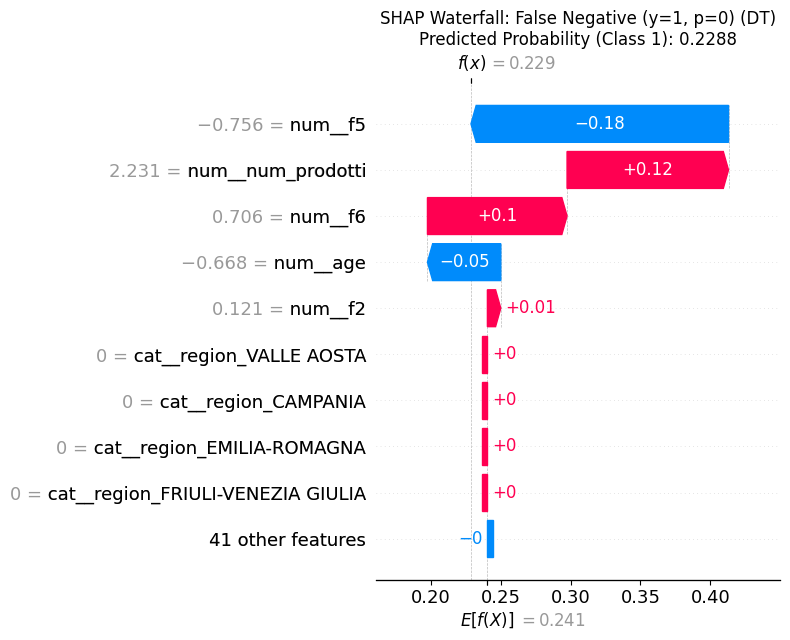


--- Waterfall: True Positive (why it succeeded) ---
Waterfall plot saved to: artifacts/dt/shap_waterfall_True_Positive__y_1__p_1__dt_with_fine_tuning.png


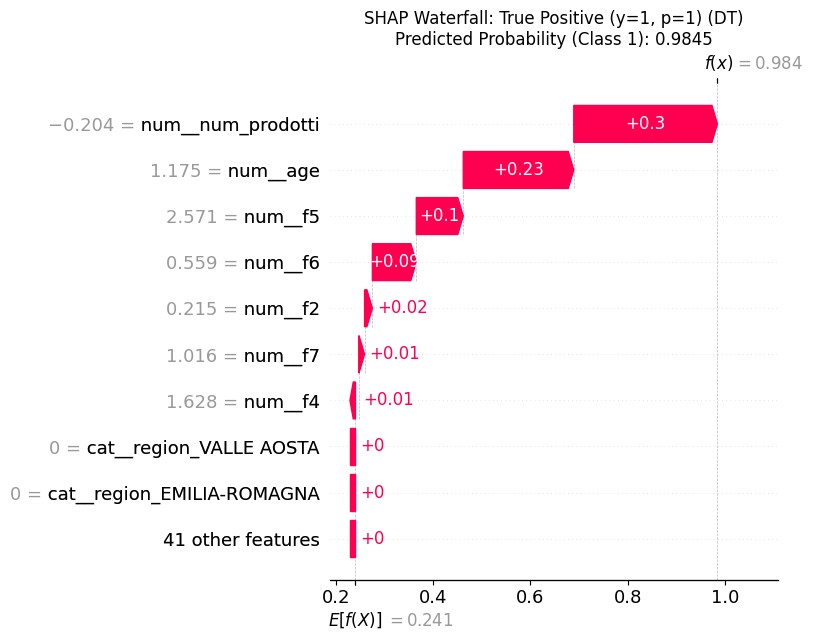

Rendering Decision Tree (Max Depth: 4)...


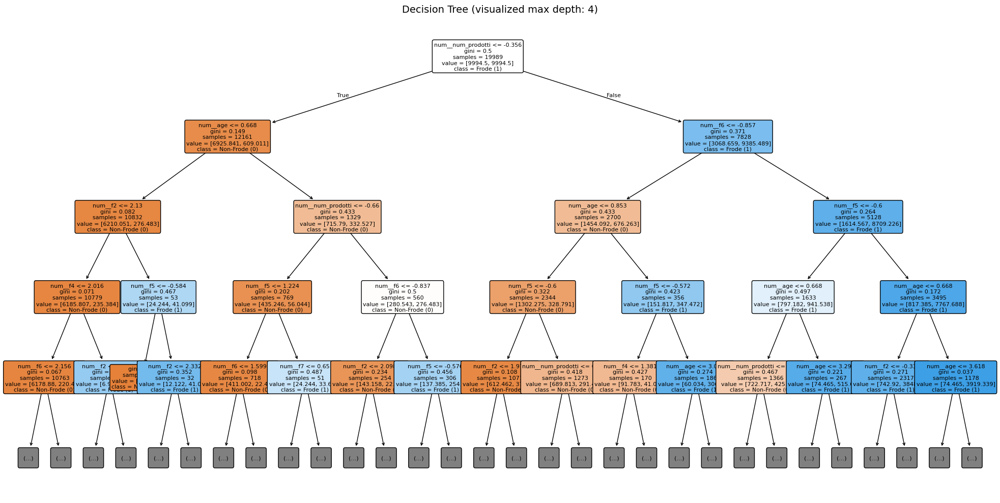

Tree saved to: artifacts/dt/decision_tree_dt_with_fine_tuning.png
Top-15 feature importance by feature_importances_:


/opt/anaconda3/envs/esercizio-env/lib/python3.12/site-packages/mlflow/types/utils.py:452: UserWarning:

Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details.

Successfully registered model 'dt_with_fine_tuning'.
2025/09/30 19:07:42 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: dt_with_fine_tuning, version 1
Created ver

🏃 View run dt_with_fine_tuning at: http://127.0.0.1:8080/#/experiments/296212722143189239/runs/692ab7c8e08f4f3fab60a7a38f74b4b7
🧪 View experiment at: http://127.0.0.1:8080/#/experiments/296212722143189239
Building estimator and pipeline for rf...
Fitting pipeline without RandomizedSearchCV...
Computing predicted probabilities...
Evaluation complete.


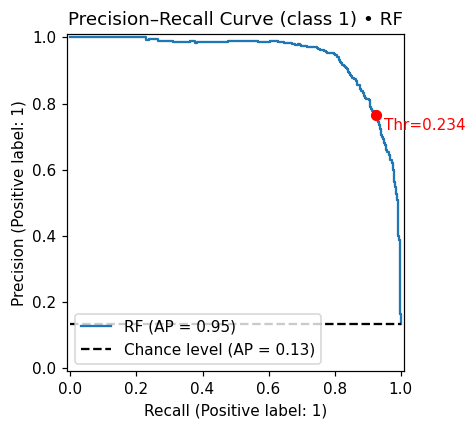

100%|===================| 995/1000 [01:23<00:00]        


--- Beeswarm Plot (Effect and Distribution) ---
Beeswarm plot saved to: artifacts/rf/shap_beeswarm_rf_simple.png


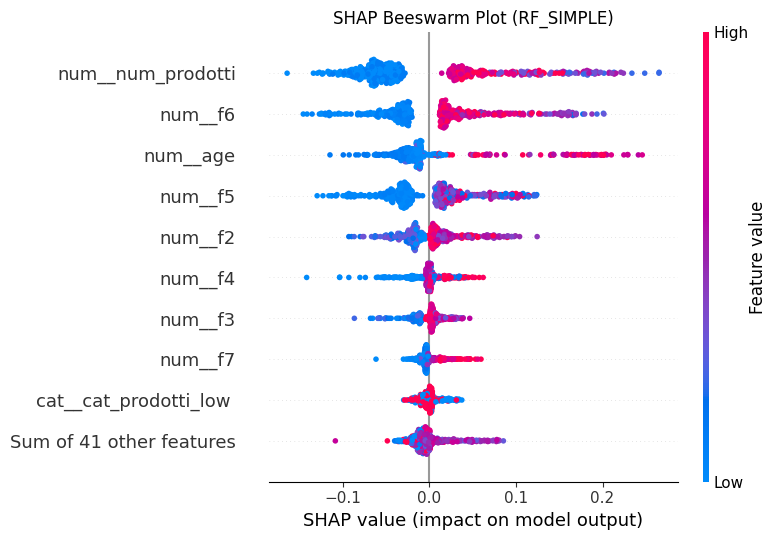


--- Global Feature Importance (Mean Absolute SHAP) ---
Global importance bar plot saved to: artifacts/rf/shap_global_bar_rf_simple.png


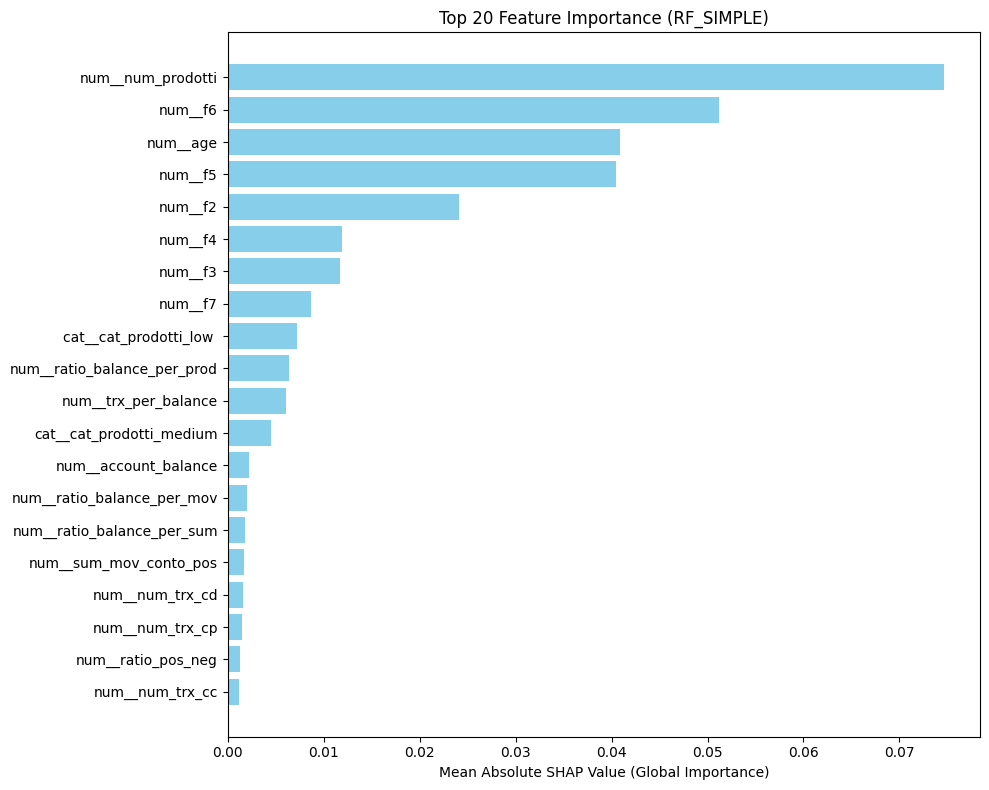


--- Waterfall: False Negative (why it failed) ---
Waterfall plot saved to: artifacts/rf/shap_waterfall_False_Negative__y_1__p_0__rf_simple.png


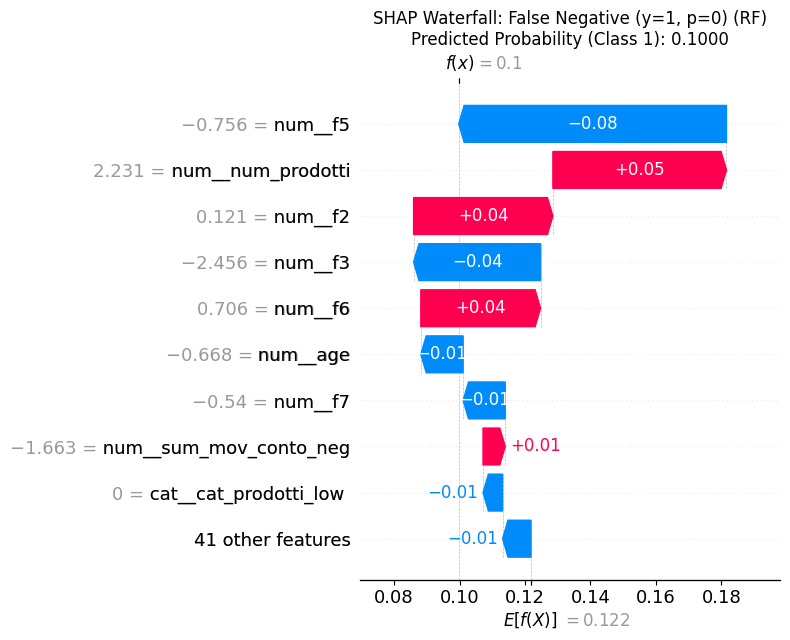


--- Waterfall: True Positive (why it succeeded) ---
Waterfall plot saved to: artifacts/rf/shap_waterfall_True_Positive__y_1__p_1__rf_simple.png


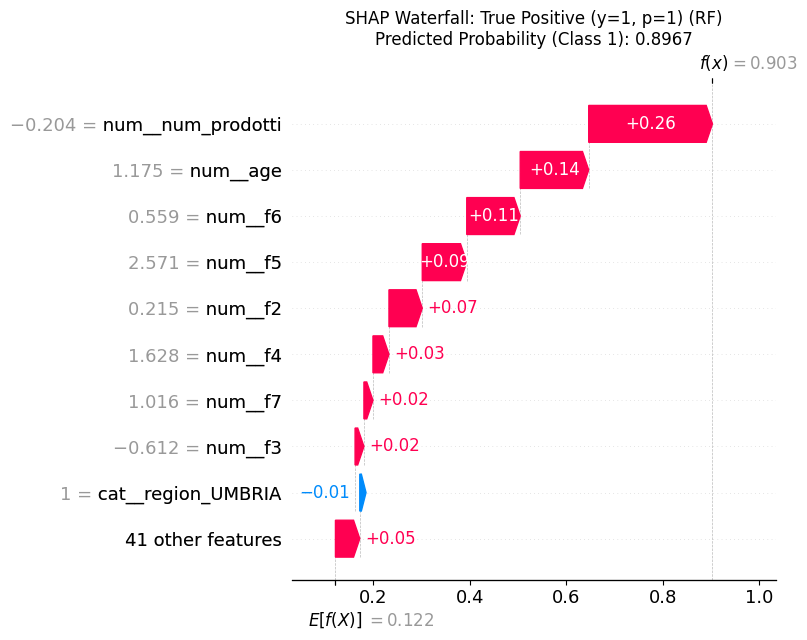

Top-15 feature importance by feature_importances_:


/opt/anaconda3/envs/esercizio-env/lib/python3.12/site-packages/mlflow/types/utils.py:452: UserWarning:

Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details.

Successfully registered model 'rf_simple'.
2025/09/30 19:09:24 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: rf_simple, version 1
Created version '1' of model 'r

🏃 View run rf_simple at: http://127.0.0.1:8080/#/experiments/296212722143189239/runs/f2436e9faca34be6af15ddc850cec38a
🧪 View experiment at: http://127.0.0.1:8080/#/experiments/296212722143189239
Building estimator and pipeline for rf...
Running RandomizedSearchCV (n_iter=30, scoring='make_scorer(recall_score, response_method='predict', pos_label=1)')...
Best params found by RandomizedSearchCV: {'n_estimators': 200, 'min_samples_split': 2, 'max_depth': 3}
Fit complete.
Computing predicted probabilities...
Evaluation complete.


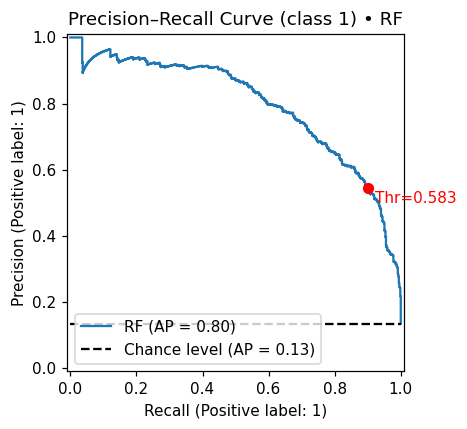


--- Beeswarm Plot (Effect and Distribution) ---
Beeswarm plot saved to: artifacts/rf/shap_beeswarm_rf_with_fine_tuning.png


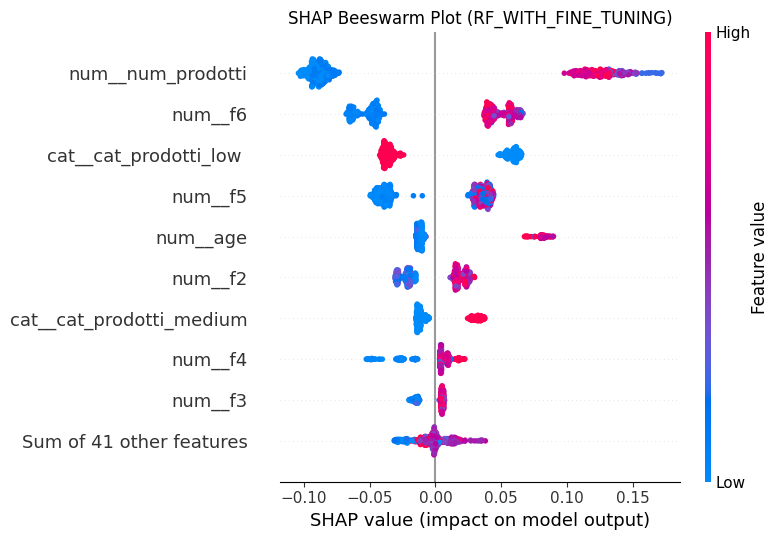


--- Global Feature Importance (Mean Absolute SHAP) ---
Global importance bar plot saved to: artifacts/rf/shap_global_bar_rf_with_fine_tuning.png


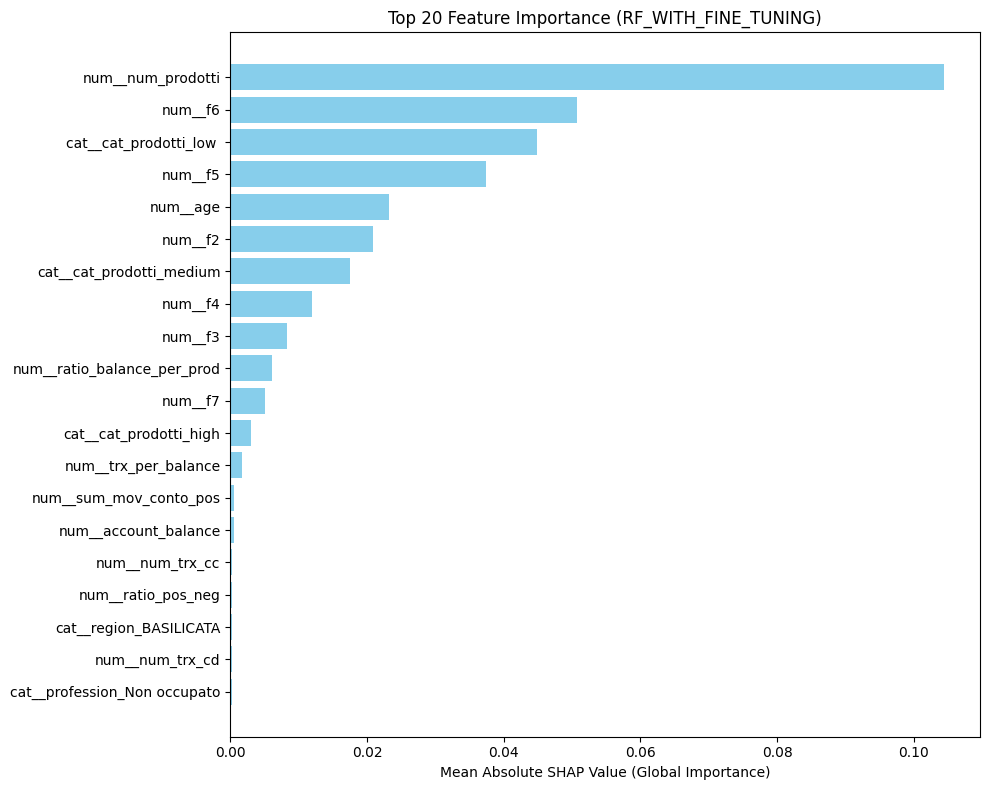


--- Waterfall: False Negative (why it failed) ---
Waterfall plot saved to: artifacts/rf/shap_waterfall_False_Negative__y_1__p_0__rf_with_fine_tuning.png


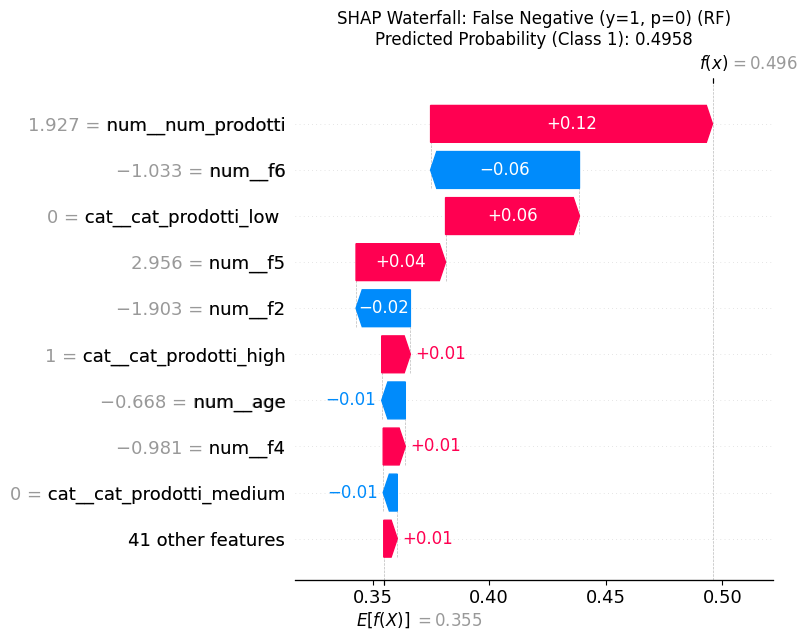


--- Waterfall: True Positive (why it succeeded) ---
Waterfall plot saved to: artifacts/rf/shap_waterfall_True_Positive__y_1__p_1__rf_with_fine_tuning.png


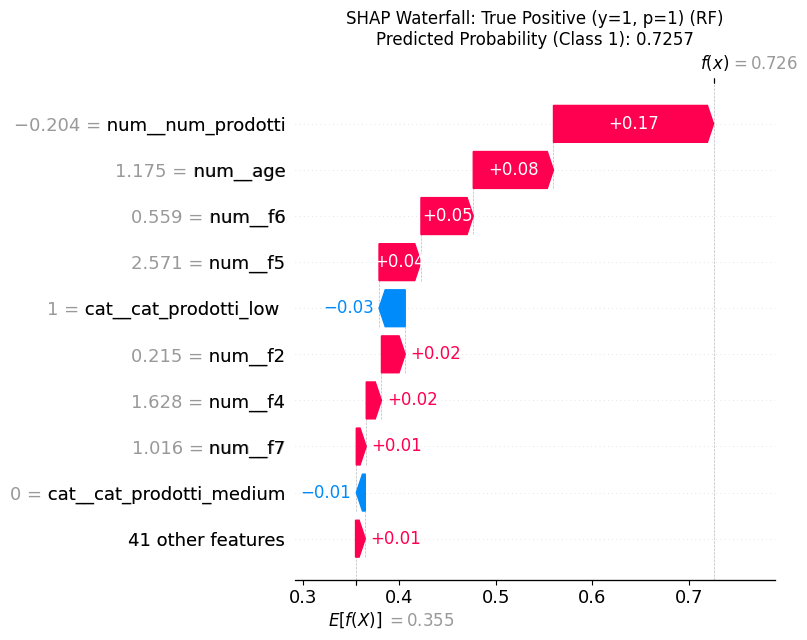

Top-15 feature importance by feature_importances_:


/opt/anaconda3/envs/esercizio-env/lib/python3.12/site-packages/mlflow/types/utils.py:452: UserWarning:

Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details.

Successfully registered model 'rf_with_fine_tuning'.
2025/09/30 19:11:07 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: rf_with_fine_tuning, version 1


🏃 View run rf_with_fine_tuning at: http://127.0.0.1:8080/#/experiments/296212722143189239/runs/f85082b4cb2047d191d8e013afe26d7a
🧪 View experiment at: http://127.0.0.1:8080/#/experiments/296212722143189239


Created version '1' of model 'rf_with_fine_tuning'.


In [35]:
recall_pos = make_scorer(recall_score, pos_label=1)
top_n = 15

models = {}


for model in ['logreg', 'dt', 'rf']:  # estendi se vuoi
    for fine_tuning in [False, True]:  # metti True se vuoi il random search
        run_name = f"{model}_{'with_fine_tuning' if fine_tuning else 'simple'}"

        Trainer = ModelTrain(
            X_train, X_test, y_train, y_test,
            random_state=RANDOM_STATE,
            model_name=model,
            tag=run_name,
            do_random_search=fine_tuning,
            scoring=recall_pos
        )
        Trainer.fit()

        report = Trainer.evaluate(tune_threshold=True)
        pipe = Trainer.pipeline_

        y_prob = report['y_prob']
        path_art = Path(f"artifacts/{Trainer.model_name}")
        path_art.mkdir(parents=True, exist_ok=True)

        # Precision-Recall
        pr_file = path_art / f"precision_recall_{run_name}.png"
        Trainer.plot_precision_recall(
            y_prob, save=True, show_threshold=report['best_threshold'], filename=pr_file
        );
        
        # SHAP
        try:
            Trainer.shap_importance(save=True, path=path_art);
        except:
            pass

        # Decision Tree (solo per DT)
        if model == 'dt':
            dt_file = path_art / f"decision_tree_{run_name}.png"
            Trainer.plot_decision_tree(max_depth=4, save=True, filename=dt_file);

        # Feature importance
        df_feature_imp = Trainer.feature_importance(top_n=top_n).sort_values('importance', ascending=True)
        ax = df_feature_imp.plot(
            kind='barh', x='feature', y='importance', legend=False, figsize=(8, 6),
            title=f"Top {top_n} Feature Importance ({model.upper()})"
        );
        fig = ax.get_figure()
        fig.tight_layout()
        fi_file = path_art / f"feature_importance_{run_name}.png"
        fig.savefig(fi_file, dpi=300)
        plt.close(fig)
        
        
        models[run_name] = Trainer

        # --- MLflow ---
        """
        with mlflow.start_run(run_name=run_name):

            # Parametri
            mlflow.log_params({k: str(v) for k, v in report.get('params', {}).items()})

            # Metriche
            mlflow.log_metric("accuracy", report['accuracy'])
            mlflow.log_metric("recall_frode", report['metrics_per_class']['frode']['recall'])
            mlflow.log_metric("precision_frode", report['metrics_per_class']['frode']['precision'])
            mlflow.log_metric("f1_frode", report['metrics_per_class']['frode']['f1'])
            mlflow.log_metric("brier_score", report['brier_score'])
            mlflow.log_metric("average_precision_class1", report['average_precision_class1'])
            mlflow.log_metric("best_threshold", report['best_threshold'])

            # Grafici
            mlflow.log_artifact(str(pr_file), artifact_path="plots")
            mlflow.log_artifact(str(fi_file), artifact_path="plots")
            
            try:
                mlflow.log_artifact(str(path_art / f"shap_beeswarm_{Trainer.tag}.png"), artifact_path="plots")
                mlflow.log_artifact(str(path_art / f"shap_global_bar_{Trainer.tag}.png"), artifact_path="plots")
                mlflow.log_artifact(str(path_art / f"shap_waterfall_Falso_Negativo__y_1__p_0__{Trainer.tag}.png"), artifact_path="plots")
                mlflow.log_artifact(str(path_art / f"shap_waterfall_Vero_Positivo__y_1__p_1__{Trainer.tag}.png"), artifact_path="plots")
            except:
                pass
            if model == 'dt':
                mlflow.log_artifact(str(dt_file), artifact_path="plots")

    
            signature = infer_signature(X_test, pipe.predict(X_test))
            mlflow.sklearn.log_model(
                sk_model=pipe,
                name=run_name,
                signature=signature,
                input_example=X_test.head(5),
                registered_model_name=run_name  # opzionale: richiede Model Registry attivo
            )

            mlflow.set_tags({
                "Training Info": f"Basic {model} for Fraud Detection",
                "model_name": run_name,
                "fine_tuning": str(fine_tuning)
            })
            """

In [39]:
"""
import mlflow.sklearn
"""
import pickle

"""

model_name = "dt_with_fine_tuning"
model_version = 1

model = mlflow.sklearn.load_model(
    model_uri=f"models:/{model_name}/{model_version}"
)

with open("dt_with_fine_tuning.pkl", "wb") as f:
    pickle.dump(model, f)
"""

In [40]:
with open("dt_with_fine_tuning.pkl", "rb") as f:
    model = pickle.load(f)

# Valutazione del modello
Da sx verso destra:
- Random Forest con tuning
- Random Forest senza tuning
- Decision Tree con tuning
- Decision Tree senza tuning
- Logistic Regression con tuning
- Logistic Regression senza tuning
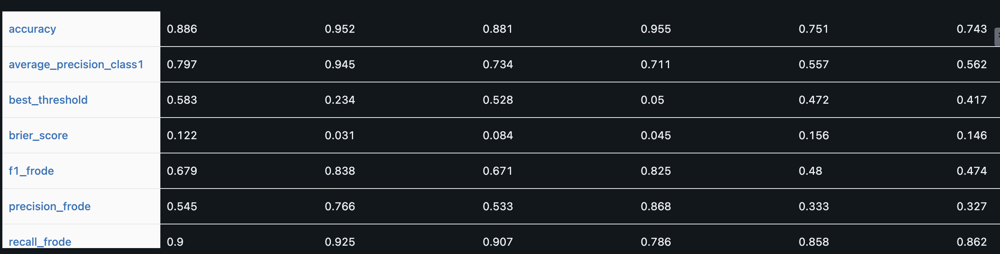

Leggiamo un po' di dati:

### Precision@k e Recall@k
Oridiniamo gli userid in base alla probabilità predetta di essere frodi e calcoliamo precision@k e recall@k per k=5%, 10% del dataset di test.

**Top 5% (k=249 clienti):**
- Precision = 0.888 → 8 clienti su 10 segnalati come “più rischiosi” sono davvero frodi.
- Recall = 0.33 → con questi 249 clienti catturi il 30.5% di tutte le frodi.
- TP = 221 → 221 frodi vere intercettate su ~669 totali nel test.

**Top 10% (k=499 clienti)**
- Precision = 0.758 → ~7 su 10 segnalati sono frodi.
- Recall = 0.565 → con questi 499 clienti catturi il 56.5% di tutte le frodi.
- TP = 378 → 378 frodi catturate.


### Curva di calibrazione
Notiamo che **all'aumentare della probabilità predetta, la probabilità reale di frode aumenta**. Tuttavia, il modello tende a sovrastimare la probabilità di frode (la curva è sempre sotto la diagonale). Questo potrebbe essere dovuto al fatto che il dataset è sbilanciato e il modello non riesce a catturare bene la variabilità della classe minoritaria.

### Bier
È la media quadratica dell’errore di probabilità, il Brier combina sia accuratezza di classificazione che calibrazione delle probabilità. Sta in un range [0,1] e più basso è meglio è.

$\text{Brier} = \frac{1}{N} \sum_i (p_i - y_i)^2 = 0.10$

PR-AUC (Average Precision): 0.733510632320653
ROC-AUC: 0.947395135735943
Top 5% (k=249) → Precision=0.888, Recall=0.330, TP catturati=221
Top 10% (k=499) → Precision=0.758, Recall=0.565, TP catturati=378
   threshold   TP    FP    TN   FN  precision    recall
8        0.9  280    33  4296  389   0.894569  0.418535
7        0.8  538   250  4079  131   0.682741  0.804185
6        0.7  549   276  4053  120   0.665455  0.820628
5        0.6  607   532  3797   62   0.532924  0.907324
4        0.5  616   592  3737   53   0.509934  0.920777
3        0.4  617   600  3729   52   0.506984  0.922272
2        0.3  618   642  3687   51   0.490476  0.923767
1        0.2  638   895  3434   31   0.416177  0.953662
0        0.1  651  1115  3214   18   0.368630  0.973094


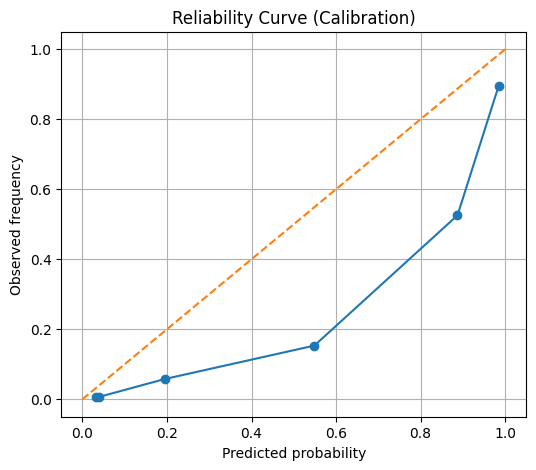

Brier score (↓ meglio): 0.08408464542925591


In [45]:
import numpy as np
import pandas as pd
from sklearn.metrics import (
    precision_recall_curve, average_precision_score, roc_auc_score,
    confusion_matrix, brier_score_loss
)
from sklearn.calibration import calibration_curve
import matplotlib.pyplot as plt

# Probabilità previste sul test set
y_prob = model.predict_proba(X_test)[:, 1]

# --- 1) PR-AUC e ROC-AUC
print("PR-AUC (Average Precision):", average_precision_score(y_test, y_prob))
print("ROC-AUC:", roc_auc_score(y_test, y_prob))

# --- 2) Precision@k e Recall@k (esempio: top 5% e top 10%)
def prec_recall_at_k(y_true, y_score, top_frac=0.05):
    n = len(y_true)
    k = max(1, int(np.floor(n * top_frac)))
    idx = np.argsort(y_score)[::-1][:k]
    y_pred_topk = np.zeros(n, dtype=int)
    y_pred_topk[idx] = 1
    tp = ((y_pred_topk == 1) & (y_true == 1)).sum()
    fp = ((y_pred_topk == 1) & (y_true == 0)).sum()
    fn = ((y_pred_topk == 0) & (y_true == 1)).sum()
    precision = tp / (tp + fp + 1e-12)
    recall = tp / (tp + fn + 1e-12)
    return precision, recall, k, tp

for frac in [0.05, 0.10]:
    p_at_k, r_at_k, k, tp = prec_recall_at_k(y_test.values, y_prob, top_frac=frac)
    print(f"Top {int(frac*100)}% (k={k}) → Precision={p_at_k:.3f}, Recall={r_at_k:.3f}, TP catturati={tp}")

# --- 3) Tabella confusion per più soglie (utile per scegliere la soglia con vincoli business)
def confusion_by_thresholds(y_true, y_score, thresholds):
    rows = []
    for t in thresholds:
        y_pred = (y_score >= t).astype(int)
        tn, fp, fn, tp = confusion_matrix(y_true, y_pred).ravel()
        precision = tp / (tp + fp + 1e-12)
        recall = tp / (tp + fn + 1e-12)
        rows.append({"threshold": t, "TP": tp, "FP": fp, "TN": tn, "FN": fn,
                     "precision": precision, "recall": recall})
    return pd.DataFrame(rows).sort_values("threshold", ascending=False)

thr_grid = np.linspace(0.1, 0.9, 9)
conf_tbl = confusion_by_thresholds(y_test.values, y_prob, thr_grid)
print(conf_tbl)

# --- 4) Calibrazione (probabilità ben calibrate → migliori priorità operative)
prob_true, prob_pred = calibration_curve(y_test, y_prob, n_bins=10, strategy="quantile")
plt.figure(figsize=(6,5))
plt.plot(prob_pred, prob_true, marker="o")
plt.plot([0,1],[0,1],"--")
plt.xlabel("Predicted probability")
plt.ylabel("Observed frequency")
plt.title("Reliability Curve (Calibration)")
plt.grid(True)
plt.show()

print("Brier score (↓ meglio):", brier_score_loss(y_test, y_prob))

# Considerazioni finali
Abbiamo scelto il modello "Decision Tree" finetunato perchè rappresenta un buon compromesso tra un modello spiegabile (grazie alla possibilità di plottare l'albero di decisione) e un modello con buone performance (come si vede dalla tabella sotto, quarta colonna da sx). Tra le altre motivazioni, ricordiamo che il Decision Tree è più robusto agli outlier rispetto alla logit e non richiede necessariamente la standardizzazione delle variabili numeriche perchè gli algoritmi ad albero non guardano le distanze tra i punti, ma vanno alla ricerca di soglie che dividono il dataset in modo ottimale. Questo aiuta ancora di più l'interpretabilità del modello.

- La recall per la classe Frode è 0.907, questo vuole dire che il 90.7% delle frodi reali vengono identificate come frodi dal modello.
- Tuttavia, la  precision è di 0.53, questo vuol dire che solo il 53% dei record segnalati dal modello come frodi sono effettivamente frodi. Questo potrebbe essere un problema in un contesto reale, in quanto si potrebbero segnalare molti clienti innocenti come frodatori, causando disagi e potenziali perdite di clienti.

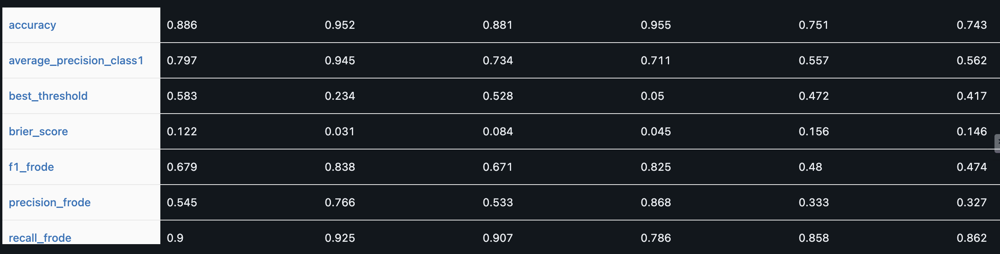

## Ultime considerazioni
- Potremmo migliorare il modello con tecniche di ensemble (XGBoost, LightGBM)
- Potremmo gestire meglio evevntuali outlier, ma ricordiamo che gli alberi sono robusti a questo. Se ci sono outlier, questi potrebbero finire semplicemente in foglie a parte dell'albero.
- Potremmo applicare trasformazioni logaritmi ad alcune variaibli numeriche poiché molte di queste sono molto asimmetriche. Negli algoritmi ad albero, potrebbe accadare che alcune soglie vengano scelte in modo non ottimale a causa della presenza di **molti** dati "grandi".
- Invece di aumentare il numero di feature attraverso il OHE, si potrebbe provare il Target Encoding, ma richiede un po' più di attenzione dovuto a possibile data leakage e a valori estremi se ci sono pochi valori per categoria.
- Si potrebbe anche provare la feature selection per ridurre il numero di feature e migliorare l'interpretabilità del modello. Tuttavia, già la Logistic Regression con L2 regolarization fa una sorta di feature selection. Per ciò che concerne gli alberi, Random Forest è governato dal parametro max_features, mentre il Decision Tree sceglie la feature solo se la ritiene utile.